# Introduction to Plotly

## Introduction

This notebook and accompanying webinar was developed and released by the [enDAQ team](https://endaq.com/). This is the third "chapter" of our series on *Python for Mechanical Engineers*:
1. [Get Started with Python](https://colab.research.google.com/drive/1_pcGtgJleapV9tz5WfuRuqfWryjqhPHy#scrollTo=ikUJITDDIp19)
  * Blog: [Get Started with Python: Why and How Mechanical Engineers Should Make the Switch](https://blog.endaq.com/get-started-with-python-why-how-mechanical-engineers-should-make-the-switch)
2. [Introduction to Numpy & Pandas for Data Analysis](https://colab.research.google.com/drive/1O-VwAdRoSlcrineAk0Jkd_fcw7mFGHa4#scrollTo=ce97q1ZcBiwj)
3. **Introduction to Plotly for Plotting Data**
  * [Watch Recording of This](https://info.endaq.com/generate-beautiful-interactive-plots-using-plotly)
4. [Introduction of the enDAQ Library](https://colab.research.google.com/drive/1WAtQ8JJC_ny0fki7eUABACMA-isZzKB6)

To sign up for future webinars and watch previous ones, [visit our webinars page](https://endaq.com/pages/shock-vibration-webinars). 

### Recap of Python Introduction

1. Python is popular for good reason
2. There are many ways to interact with Python
  * Here we are in Google Colab based on Jupyter Notebooks
3. There are many open source libraries to use
  * Today we are covering Plotly for plotting

<img src="https://info.endaq.com/hubfs/20210928-python-ide-libraries-inforgraphic-FINAL-2.png" width="700">

## Why Do We Plot?

- To Understand Relationships, Make an Observation
  - Interactivity Matters!
- To Share & Present
  - Beautiful Matters!

![all-plotly-images.png](https://info.endaq.com/hubfs/all-plotly-images.png)

## Overview of Python Plotting Libraries
Like everything in Python, there are a few options for plotting data! We'll focus on Plotly but quickly cover:
- Matplotlib 
- Seaborn 
- ggplot 
- bokeh
- Plotly


### Data Source
For some shock data, we'll use the motorcycle crash test data discussed in our [blog post on pseudo velocity](https://blog.endaq.com/shock-analysis-response-spectrum-srs-pseudo-velocity-severity). This was filtered with a 150 low pass filter first to clean the signal using the endaq library (which uses SciPy under the hood).

In [ ]:
import pandas as pd

df = pd.read_csv('https://info.endaq.com/hubfs/data/motorcycle-crash.csv',index_col=0)

In [ ]:
df

,X (500g),Y (500g),Z (500g)
timestamp,,,
0.00000,-0.055582,0.033337,0.032217
0.00010,-0.056731,0.041513,0.032720
0.00020,-0.056972,0.049888,0.033106
0.00030,-0.056273,0.058399,0.033419
0.00040,-0.054605,0.066982,0.033706
...,...,...,...
0.19952,0.383610,0.117662,-0.292337
0.19962,0.411270,0.135782,-0.275515
0.19972,0.438324,0.153832,-0.258591


### [Matplotlib](https://matplotlib.org/)
The most popular plotting library and the default go-to. But... there is a new game in town!

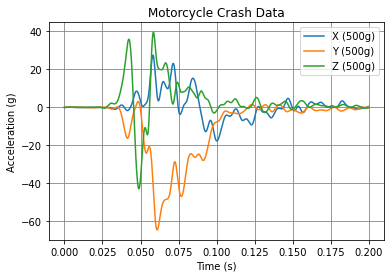

In [ ]:
import matplotlib.pyplot as plt

plt.plot(df)
plt.title('Motorcycle Crash Data')
plt.ylabel('Acceleration (g)')
plt.xlabel('Time (s)')
plt.legend(df.columns)
plt.grid(color='grey')
plt.show()

### [Seaborn](https://seaborn.pydata.org/)
A wrapper around Matplotlib to simplify the interface, beautify the plots, and support more stats-based analysis. Here is their [documentation specifically on aesthetics](http://seaborn.pydata.org/tutorial/aesthetics.html), they care too!

Text(0.5, 0, 'Time (s)')

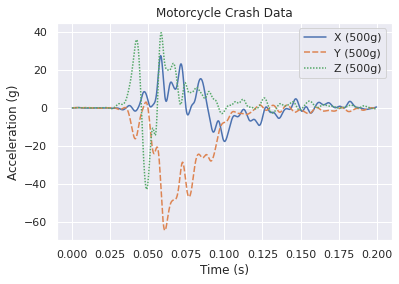

In [ ]:
import seaborn as sns

sns.set_theme()

p = sns.lineplot(data=df)
p.set_title('Motorcycle Crash Data')
p.set_ylabel('Acceleration (g)')
p.set_xlabel('Time (s)')

### [ggplot](https://plotnine.readthedocs.io/en/stable/)
Introduces a "grammer of graphics" logic to plotting data which allows explicit mapping of data to the visual representation. This is something plotly express excels at.

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


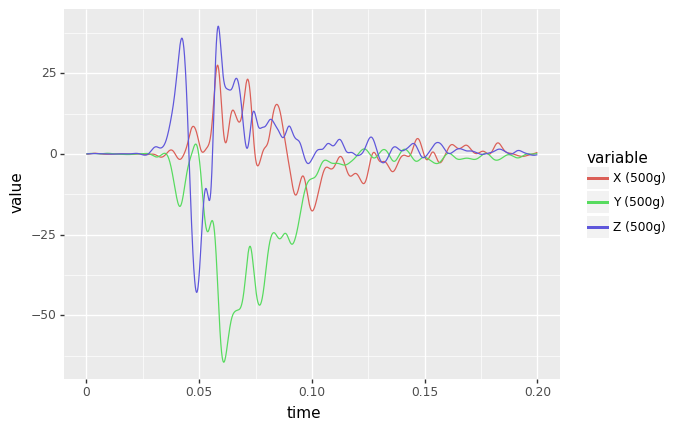

<ggplot: (8785480354521)>

In [ ]:
from plotnine import ggplot, aes, geom_line

df_ggplot = df.copy()
df_ggplot['time'] = df.index
df_ggplot = pd.melt(df_ggplot, id_vars='time')
df_ggplot

(
    ggplot(df_ggplot)  # What data to use
    + aes(x="time", y='value',color='variable')  # What variable to use
    + geom_line()  # Geometric object to use for drawing
)

### [Bokeh](https://bokeh.org/)
Finally, we have interactivity!

In [ ]:
from bokeh.plotting import figure, show
from bokeh.io import output_notebook

output_notebook()

p = figure(title='Motorcycle Crash Data',
           x_axis_label='Time (s)',
           y_axis_label='Acceleration (g)')

colors = ['red','green','blue']
for c,color in zip(df.columns,colors):
  p.line(df.index, df[c], legend_label = c, line_color = color, line_width = 2)

show(p)

### [Plotly](https://plotly.com/python/)
Interactive, beautiful, easy!

In [ ]:
!pip install -U -q plotly

     |████████████████████████████████| 23.9 MB 1.5 MB/s 


In [ ]:
import plotly.express as px
import plotly.io as pio; pio.renderers.default = "iframe"

fig = px.line(df)
fig.update_layout(
    title_text = 'Motorcycle Crash Data',
    xaxis_title_text = "Time (s)",
    yaxis_title_text = "Acceleration (g)")
fig.show()

## How Does Plotly Work?

There are three main components to how/why Plotly works:
1. [Python Library](https://plotly.com/python/)
2. [Figure Objects](https://plotly.com/python/figure-structure/)
3. [JavaScript Library](https://plotly.com/javascript/)

To illustrate this relationship, let's make a Plotly Treemap!

In [ ]:
df_tree = pd.DataFrame({
    'names': ["Plotly","Python", "Figure Object", "JavaScript", "Express", "Graph Objects","Data","Layout",'Frames',"Plotly.js"],
    'parents' : ["", "Plotly", "Plotly", "Plotly", "Python",'Express',"Figure Object","Figure Object","Figure Object","JavaScript"]
})

In [ ]:
fig = px.treemap(
    names = df_tree.names,
    parents = df_tree.parents
)
fig.update_traces(root_color="lightgrey")
fig.update_layout(
  font_family='Open Sans',
  font_size=32)
fig.show()

Plotly Express was introduced in May 2019 and is a GAME CHANGER! [Here is the introduction article](https://medium.com/plotly/introducing-plotly-express-808df010143d).
![plotly-introduces-express.png](https://info.endaq.com/hubfs/plotly-introduces-express.png)

## Shoutout to Plotly's Docs

Before we proceed, I want to really stress how good the docs are from Plotly. They have a TON of examples, and very good documentation. We'll be focusing on [Plotly Express](https://plotly.com/python/plotly-express/).

![plotly-express-plot-types.gif](https://info.endaq.com/hubfs/plotly-express-plot-types.gif)

They also have their own [community forum](https://community.plotly.com/c/graphing-libraries/python/10) that is pretty rich with examples and people helping each other out.

## Styling Figures

### Example Data
Here, to mix it up, we'll calculate a shock response spectrum from the acceleration data to then be plotting on a log log scale to help show how to style that.

In [ ]:
!pip install -q endaq
import endaq
import numpy as np

In [ ]:
def get_log_freqs(df,init_freq=1,bins_per_octave=12):
  """Given a timebased dataframe, return a log spaced frequency array up to the Nyquist frequency"""
  fs = (df.shape[0]-1)/(df.index[-1]-df.index[0])
  return 2 ** np.arange(np.log2(init_freq),
                        np.log2(fs/2),
                        1/bins_per_octave)

In [ ]:
df_pvss = endaq.calc.shock.pseudo_velocity(df, 
                                           get_log_freqs(df,init_freq=1,bins_per_octave=12),
                                           damp=0.05, two_sided=False)
df_pvss = df_pvss*9.81*39.37 #convert to in/s

In [ ]:
df_pvss

,X (500g),Y (500g),Z (500g)
frequency (Hz),,,
1.000000,47.804683,473.402407,148.658683
1.059463,49.240508,493.307994,154.812945
1.122462,50.532563,513.039780,160.893921
1.189207,51.637517,532.374454,166.829370
1.259921,52.551121,551.046158,172.533775
...,...,...,...
3866.109185,0.437852,1.025865,0.681822
4096.000000,0.413256,0.968276,0.643536
4339.560834,0.390047,0.913923,0.607404


### Manually Defining the Theme
First let's start by plotting with the standard theme, modifying only the titles. We'll also define the scale on the x and y axis to be a log scale.

In [ ]:
fig = px.line(df_pvss)
fig.update_layout(
    title_text = 'Motorcycle Crash Data',
    xaxis_title_text = "Natural Frequency (Hz)",
    yaxis_title_text = "Pseudo Velocity (in/s)",
    xaxis_type = "log",
    yaxis_type = "log")
fig.show()

Now let's get crazy and customize all the "common" settings. But note that there are a LOT of different parameters that can be explicitely defined. Remember, Plotly has very thorough documentation, so check it out!
* [Figure Layout](https://plotly.com/python/reference/layout/)
* [X Axis](https://plotly.com/python/reference/layout/xaxis/)
* [Y Axis](https://plotly.com/python/reference/layout/yaxis/)

You will need to [download Open Sans](https://fonts.google.com/specimen/Open+Sans) if you like the font like me too! To pick colors, I suggest [Color Hex](https://www.colorhexa.com/).

In [ ]:
fig = px.line(df_pvss)
fig.update_layout(
  font_family='Open Sans',
  font_size=16,
  font_color='#404041',

  title_text = 'Motorcycle Crash Data',
  title_font_family = 'Showcard Gothic',
  title_font_size = 32,
  title_font_color = '#e77025',
  title_x = 0.5,

  xaxis_title_text = "Natural Frequency (Hz)",
  xaxis_title_font_family = 'Algerian',
  xaxis_title_font_size = 24,
  xaxis_title_font_color = '#7f3f98',
  xaxis_type = 'log',

  yaxis_title_text ="Pseudo Velocity (in/s)",
  yaxis_title_font_family = 'Playbill',
  yaxis_title_font_size = 24,
  yaxis_title_font_color = '#be1e2d',
  yaxis_type = 'log',

  legend_bgcolor = 'yellow',
  legend_title_text = 'Legend',
  legend_title_font_size = 24,
  legend_orientation = 'v',
  legend_y = 1.0,
  legend_yanchor = 'top',
  legend_x = 1.0,
  legend_xanchor = 'right',

  plot_bgcolor = '#f3f3f3',

  width = 800,
  height = 600)
fig.show()

One thing that Plotly does which is REALLY cool is that they use ["magic underscore notation"](https://plotly.com/python/creating-and-updating-figures/#magic-underscore-notation) which means that this:
~~~
yaxis_title_font_family = 'Open Sans ExtraBold'
~~~

is the equivalent of:
~~~
{'yaxis': 
 {'title': 
  {'font': 
   {'family': 'Open Sans ExtraBold'}
  }
 }
}
~~~

Now I am particular about my plots and how they look, I think aesthetics matter! So I can create a few custom themes that can be added to figures when making them.

In [ ]:
template_light = dict(
  template="presentation",

  font_family='Open Sans',
  font_size=16,
  font_color='#404041',

  title_font_family = 'Open Sans ExtraBold',
  title_font_size = 24,
  title_x = 0.5,

  xaxis_title_font_family = 'Open Sans ExtraBold',
  xaxis_title_font_size = 20,

  yaxis_title_font_family = 'Open Sans ExtraBold',
  yaxis_title_font_size = 20,

  legend_title='',
  legend_orientation='h',
  legend_y = -0.2,
  
  plot_bgcolor = '#f3f3f3',
  yaxis_gridcolor = '#dad9d8',
  yaxis_linecolor = '#404041',
  yaxis_mirror = True,
  xaxis_gridcolor = '#dad9d8',
  xaxis_linecolor = '#404041',
  xaxis_mirror = True,  
  )

template_dark = template_light.copy()
template_dark['template'] = "plotly_dark"
template_dark['font_color'] = '#f3f3f3'
template_dark['plot_bgcolor'] = "#111111"
template_dark['yaxis_linecolor'] = "#404041"
template_dark['xaxis_linecolor'] = "#404041"
template_dark['yaxis_gridcolor'] = "#404041"
template_dark['xaxis_gridcolor'] = "#404041"


I also tend to make a lot of similar plots, so it can be helpful to define some axes labels and types as variables.

In [ ]:
template_pvss = dict(
  xaxis_title_text = "Natural Frequency (Hz)",
  xaxis_type = 'log',
  yaxis_title_text ="Pseudo Velocity (in/s)",
  yaxis_type = 'log'
)

template_psd = dict(
  xaxis_title_text = "Frequency (Hz)",
  xaxis_type = 'log',
  yaxis_title_text ="Acceleration (g^2/Hz)",
  yaxis_type = 'log'
  )

template_accel = dict(
  xaxis_title_text = "Time (s)",
  yaxis_title_text ="Acceleration (g)",
  )

In [ ]:
fig = px.line(df_pvss)
fig.update_layout(
  {**template_light, **template_pvss}, 
  title_text = 'Custom Light Theme')
fig.show()

In [ ]:
fig = px.line(df_pvss)
fig.update_layout(
  {**template_dark, **template_pvss}, 
  title_text = 'Custom Dark Theme')
fig.show()

### Themes
As you may have noticed, I used some templates in my custom theme. There are a few to pick from and you can make your own as well. This is [well documented with examples on Plotly's website](https://plotly.com/python/templates/).

In [ ]:
themes = ["plotly", "plotly_white", "plotly_dark", "ggplot2", "seaborn", "simple_white", 'presentation', "none"]

for theme in themes:
  fig = px.line(df_pvss)
  fig.update_layout(
    template_pvss,
    template = theme,
    title_text = theme,
    )
  fig.show()

### Colors

Plotly also supports a whole range of different color schemes you can implement. There are a lot of built in ones and remember, [great documentation](https://plotly.com/python/discrete-color/)!

In [ ]:
px.colors.qualitative.swatches().show()

In [ ]:
px.colors.qualitative.Alphabet

['#AA0DFE',
 '#3283FE',
 '#85660D',
 '#782AB6',
 '#565656',
 '#1C8356',
 '#16FF32',
 '#F7E1A0',
 '#E2E2E2',
 '#1CBE4F',
 '#C4451C',
 '#DEA0FD',
 '#FE00FA',
 '#325A9B',
 '#FEAF16',
 '#F8A19F',
 '#90AD1C',
 '#F6222E',
 '#1CFFCE',
 '#2ED9FF',
 '#B10DA1',
 '#C075A6',
 '#FC1CBF',
 '#B00068',
 '#FBE426',
 '#FA0087']

In [ ]:
px.colors.sequential.swatches_continuous().show()

In [ ]:
px.colors.sequential.Blackbody

['rgb(0,0,0)',
 'rgb(230,0,0)',
 'rgb(230,210,0)',
 'rgb(255,255,255)',
 'rgb(160,200,255)']

Here I'm going to make my own swatch of some kind with a custom color scale.

In [ ]:
colors = ['#EE7F27', '#6914F0', '#2DB473', '#D72D2D', '#3764FF', '#FAC85F','#27eec0','#b42d4d','#82d72d','#e35ffa']
fig = px.bar(x=np.arange(10),
             y=np.zeros(10)+1,
             color=colors,
             color_discrete_sequence=colors,
             height=200)
fig.update_layout(template_dark,
                  font_color="#111111",
                  legend_font_color="white")
fig.show()

When creating a figure you can specify the color sequence you'd like as a parameter. You can use a custom list like what I'm showing here or you can call one of the `px.colors.qualitative.` lists.

In [ ]:
fig = px.line(df_pvss,
              color_discrete_sequence=colors)

fig.update_layout(
  {**template_dark, **template_pvss}, 
  title_text = 'Custom Colors & Dashes')

fig.show()

## Saving Figures

To save static images, first you need to install kaleido.

In [ ]:
!pip install -U kaleido

     |████████████████████████████████| 79.9 MB 85 kB/s 


In colab only you'll also need to do this install.

In [ ]:
!wget https://github.com/plotly/orca/releases/download/v1.2.1/orca-1.2.1-x86_64.AppImage -O /usr/local/bin/orca
!chmod +x /usr/local/bin/orca
!apt-get install xvfb libgtk2.0-0 libgconf-2-4

Now saving an image is easy and they support a few types. More information and options available in their [docs](https://plotly.com/python/static-image-export/).

In [ ]:
fig.write_image("fig.png")
fig.write_image("fig.jpeg")
fig.write_image("fig.svg")
fig.write_image("fig.pdf")

You can also keep the interactivity by downloading an HTML file, either with or without the plotly javascript library. You'll need the library if you want to view the plots when you don't have internet access. For more, see their [docs on saving HTML files](https://plotly.github.io/plotly.py-docs/generated/plotly.io.write_html.html).

In [ ]:
fig.write_html('fig-full.html')  
fig.write_html('fig-small.html',full_html=False,include_plotlyjs='cdn')  

## Plot Types

Remember Plotly has [GREAT documentation](https://plotly.com/python/), and LOTS of plot types. Below is a GIF of their main page on all the different plot types.

![plotly-python-plot-types.gif](https://info.endaq.com/hubfs/plotly-python-plot-types.gif)

Now here are the gallery of plots all in plotly.express meaning they are super easy to create! Again, [check out the docs](https://plotly.com/python/plotly-express/).

![plotly-express-plot-types.gif](https://info.endaq.com/hubfs/plotly-express-plot-types.gif)

Now we'll go through a few relevant examples for mechanical engineers and vibration analysis.

### Bubble

In [ ]:
df_table = pd.read_csv('https://info.endaq.com/hubfs/data/endaq-cloud-table.csv')
df_table = df_table[['serial_number_id', 'file_name', 'file_size', 'recording_length', 'recording_ts',
         'accelerationPeakFull', 'psuedoVelocityPeakFull', 'accelerationRMSFull',
         'velocityRMSFull', 'displacementRMSFull', 'pressureMeanFull', 'temperatureMeanFull']].copy()

df_table['recording_ts'] = pd.to_datetime(df_table['recording_ts'], unit='s')         
df_table = df_table.sort_values(by=['recording_ts'], ascending=False)      
df_table   

,serial_number_id,file_name,file_size,recording_length,recording_ts,accelerationPeakFull,psuedoVelocityPeakFull,accelerationRMSFull,velocityRMSFull,displacementRMSFull,pressureMeanFull,temperatureMeanFull
11,11456,50_Joules_900_lbs-1629315312.ide,1597750,20.201752,2021-07-26 19:56:39,231.212,2907.650,2.423,54.507,1.066,98.745,24.175
10,11456,100_Joules_900_lbs-1629315313.ide,1596714,20.200623,2021-07-26 19:21:55,218.634,2961.256,2.877,53.875,1.053,98.751,24.180
22,9695,Tilt_000000-1625156721.IDE,719403,23.355163,2021-07-01 16:21:01,0.378,330.946,0.044,11.042,0.345,99.510,26.410
7,11162,Calibration-Shake-1632515140.IDE,2218130,27.882690,2021-05-17 19:16:10,8.783,1142.282,2.712,46.346,0.617,102.251,24.545
17,11071,surgical-instrument-1625829182.ide,541994,6.951172,2021-04-22 16:53:10,5.739,387.312,1.568,24.418,0.242,99.879,21.889
8,10916,FUSE_HSTAB_000005-1632515139.ide,537562,18.491791,2021-04-22 16:13:24,0.202,53.375,0.011,1.504,0.036,90.706,18.874
2,10118,Bolted-1632515144.ide,6149229,29.396118,2021-04-21 21:44:07,15.343,148.276,2.398,14.101,0.154,99.652,23.172
20,9680,LOC__6__DAQ41551_25_01-1625170793.IDE,8664238,63.878937,2021-03-25 04:53:27,564.966,2357.599,54.408,145.223,3.088,102.875,26.031
19,9680,LOC__4__DAQ41551_15_05-1625170794.IDE,6927958,64.486054,2021-03-25 04:22:10,585.863,2153.020,46.528,148.591,2.615,105.750,32.202
18,9680,LOC__3__DAQ41551_11_01_02-1625170795.IDE,2343292,28.456818,2021-03-25 04:06:19,622.040,8907.949,94.197,372.049,9.580,105.682,33.452


In [ ]:
fig = px.scatter(df_table, 
           x="recording_ts", 
           y="accelerationRMSFull",
           size="recording_length", 
           color="serial_number_id",
           hover_name="file_name", 
           log_y=True, 
           size_max=60)

fig.update_layout(
  template_dark,  
  title_text ='Scatter Plot with Numeric "Color"',
  xaxis_title_text ="Date of Recording",
  yaxis_title_text ="Acceleration RMS (g)"
)

fig.show()

In [ ]:
df_table['device'] = df_table["serial_number_id"].astype(str)

fig = px.scatter(df_table, 
           x="accelerationPeakFull", 
           y="velocityRMSFull",
           size="recording_length", 
           color="device",
           color_discrete_sequence=px.colors.qualitative.Light24, #I'll want to use a list with as many discrete values as I can
           hover_name="file_name", 
           log_y=True, 
           log_x=True,
           size_max=60)

fig.update_layout(
  template_dark,  
  title_text ='Scatter Plot with Text "Color"',
  xaxis_title_text ="Acceleration RMS (g)",
  yaxis_title_text ="Velocity RMS (mm/s)"
)

fig.show()

#### Drop Downs to Define X & Y Axis Columns
This function (thanks Sam!) highlights another layer of interactivity in Plotly.

In [ ]:
def get_correlation_figure_please(merged_df):
    cols = [col for col, t in zip(merged_df.columns, merged_df.dtypes) if t != object]

    start_dropdown_indices = [0, 0]

    # Create the scatter plot of the initially selected variables
    fig = px.scatter(
        merged_df,
        x=cols[start_dropdown_indices[0]],
        y=cols[start_dropdown_indices[1]]
    )

    # Create the drop-down menus which will be used to choose the desired file characteristics for comparison
    drop_downs = []
    for axis in ['x', 'y']:
        drop_downs.append([
            dict(
                method = 'update', 
                args = [
                    {axis : [merged_df[cols[k]]]},
                    {'%saxis.title.text'%axis: cols[k]},
                    # {'color':[merged_df['serial_number_id']],'color_discrete_map':SERIALS_TO_INDEX},
                ],
                label = cols[k]) for k in range(len(cols))
            ])
      
    # Sets up various apsects of the Plotly figure that is currently being produced.  This ranges from 
    # aethetic things, to setting the dropdown menues as part of the figure
    fig.update_layout(
        title_x=0.4,
        updatemenus=[{
            'active': start_j,
            'buttons': drop_down,
            'x': 1.125,
            'y': y_height,
            'xanchor': 'left',
            'yanchor': 'top',
          } for drop_down, start_j, y_height in zip(drop_downs, start_dropdown_indices, [1, .85])])
    
    return fig

In [ ]:
fig = get_correlation_figure_please(df_table)
fig.update_layout(
  template_light,  
  title_text='Selectable Drop Downs',
)
fig.show()

### Map

In [ ]:
map_data = pd.read_csv('https://info.endaq.com/hubfs/data/mide-map-gps-data.csv')
map_data

,timestamp,Latitude,Longitude,Date,Ground Speed
0,4436.395385,42.369258,-71.019592,1.619789e+09,1.014
1,4437.395355,42.369257,-71.019600,1.619789e+09,0.511
2,4438.395324,42.369257,-71.019603,1.619789e+09,0.184
3,4439.395294,42.369256,-71.019608,1.619789e+09,0.413
4,4440.395263,42.369259,-71.019605,1.619789e+09,0.341
...,...,...,...,...,...
1905,6343.337073,42.496331,-71.139950,1.619791e+09,0.170
1906,6344.337041,42.496331,-71.139949,1.619791e+09,0.025
1907,6345.337008,42.496330,-71.139949,1.619791e+09,0.166
1908,6346.336976,42.496329,-71.139950,1.619791e+09,0.117


You need a [mapbox token](https://www.mapbox.com/) here, which is free up to 50,000 "loads" per month.

In [ ]:
import os
from dotenv import load_dotenv

load_dotenv()

MAPBOX_ACCESS_TOKEN = os.getenv('MAPBOX_ACCESS_TOKEN')

In [ ]:
px.set_mapbox_access_token(MAPBOX_ACCESS_TOKEN)
fig = px.scatter_mapbox(map_data, 
                        lat="Latitude", 
                        lon="Longitude",  
                        color="Ground Speed",
                        zoom=10)
fig.update_layout(
  template_dark,  
  title_text ='Mide to Airport Drive',
  coloraxis_showscale=False)
fig.show()

### 3D Line

In [ ]:
df_rolling_psd = pd.read_csv('https://info.endaq.com/hubfs/data/rolling-psd.csv',index_col=0)
df_rolling_psd

,frequency (Hz),X (40g),Y (40g),Z (40g),Resultant,Time
0,1.000000,1.021500e-04,1.632998e-04,6.043786e-05,3.258877e-04,65.0
1,1.259921,1.267597e-04,1.210042e-04,7.970037e-05,3.274643e-04,65.0
2,1.587401,1.159243e-04,1.182557e-04,6.159546e-05,2.957754e-04,65.0
3,2.000000,2.432255e-04,9.195336e-05,8.133421e-05,4.165131e-04,65.0
4,2.519842,1.447308e-04,2.526833e-05,5.100299e-05,2.210021e-04,65.0
...,...,...,...,...,...,...
20,101.593667,3.904692e-07,7.823465e-07,4.461462e-06,5.634277e-06,6285.0
21,128.000000,1.520778e-07,5.739868e-08,5.433635e-07,7.528400e-07,6285.0
22,161.269894,6.667854e-08,2.399063e-08,4.284568e-08,1.335149e-07,6285.0
23,203.187335,1.048538e-08,9.798779e-09,8.675933e-09,2.896009e-08,6285.0


In [ ]:
fig = px.line_3d(df_rolling_psd,
                 x='frequency (Hz)',
                 y='Time',
                 z='Resultant',
                 color='Time',
                 log_x=True,
                 log_z=True,
                 color_discrete_sequence=['#EE7F27']
           )

fig.update_layout(
  template_dark,  
  title_text ='3D PSD',
  legend_orientation='v',
  legend_y = 0.0,
  )
fig.show()

### Animation

In [ ]:
fig = px.line(
    df_rolling_psd,
    x="frequency (Hz)",
    y="Resultant",
    animation_frame="Time",
    color_discrete_sequence=['#EE7F27']
)

fig.update_layout(
  {**template_dark, **template_psd}, 
  title_text = 'Animation of Moving PSD',
  legend_orientation = 'v',
  legend_y = 1.0,
  legend_yanchor = 'top',
  legend_x = 1.0,
  legend_xanchor = 'right')

fig.show()

In [ ]:
import plotly.graph_objects as go

def quantile_from_rolling_psd(rolling_psd,column,quantile):
  """Get the respective quantile of the defined column for all frequencies in the rolling psd"""
  freqs = rolling_psd["frequency (Hz)"].drop_duplicates().to_numpy()
  df = pd.Series(index=freqs,name='Quantile',dtype='float64')
  df['Quantile'] = 0
  for f in freqs:
    df_quant = rolling_psd[rolling_psd['frequency (Hz)'] == f].quantile(quantile)
    df.loc[f,'Quantile'] = df_quant[column]
  return df
  
def add_quantile(rolling_psd,column,quantile,name,color,dash):
  quant = quantile_from_rolling_psd(rolling_psd,column,quantile)
  fig.add_trace(
      go.Scatter(
          x=quant.index,
          y=quant.values,
          name=name,
          line=dict(color=color, dash=dash),
      )
  )

add_quantile(df_rolling_psd,'Resultant',1.0,"Max","#6914F0","solid")
add_quantile(df_rolling_psd,'Resultant',0.5,"Median","#6914F0","dash")
add_quantile(df_rolling_psd,'Resultant',0.0,"Min","#6914F0","solid")
fig.write_html('psd-animation.html',full_html=False,include_plotlyjs='cdn') 
fig.show()

### Large Time Series
The one bad thing about plotly is that it makes your browser load all the data points into memory. It therefore can crash if you are trying to plot too many data points.

In [ ]:
df_vibe = pd.read_csv('https://info.endaq.com/hubfs/data/motorcycle-vibration-moving-frequency.csv',index_col=0)
df_vibe = df_vibe - df_vibe.median()
df_vibe

,X (40g),Y (40g),Z (40g)
timestamp,,,
0.402069,-0.390691,0.017191,-0.847865
0.402318,-0.172913,0.071447,-0.826096
0.402567,1.089847,1.284786,0.356687
0.402816,0.296012,1.093866,-0.054382
0.403066,-0.111124,0.318515,-0.624797
...,...,...,...
99.726203,0.260407,-0.161978,-0.047653
99.726453,-0.552108,-0.073261,-0.077179
99.726703,-0.280525,-0.001577,-0.057706


#### Render an Image
To get around this we can render the figure as an image ([see docs for more information](https://plotly.com/python/renderers/)).

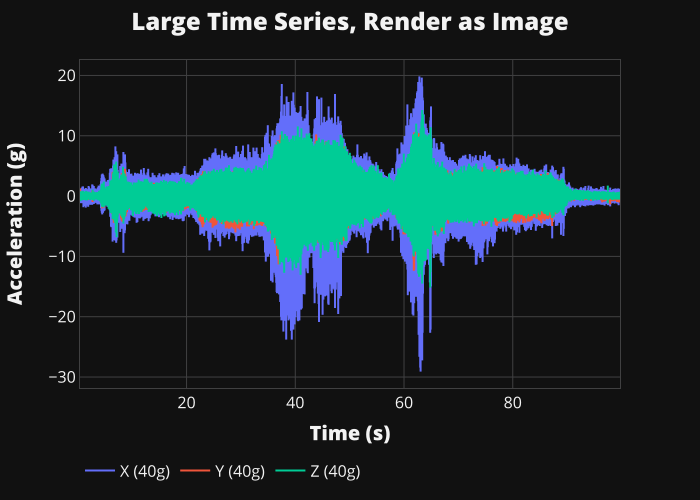

In [ ]:
fig = px.line(df_vibe)

fig.update_layout(
  {**template_dark, **template_accel}, 
  title_text = 'Large Time Series, Render as Image')

fig.show(renderer="svg")

The other issue I have is that the order in which we plot matters with how we view and understand the data which isn't good!

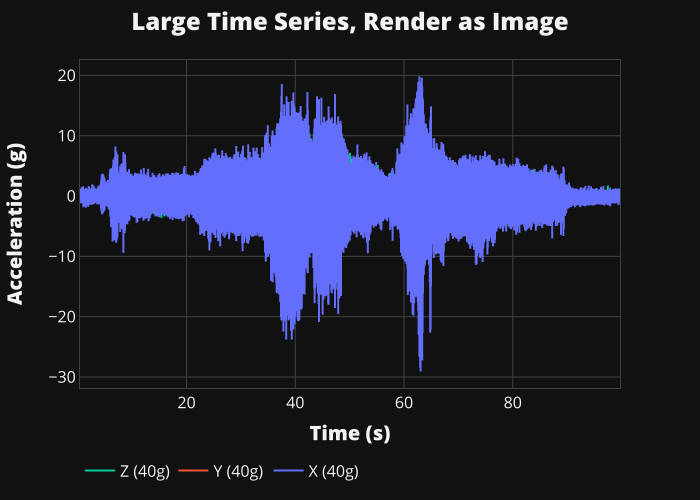

In [ ]:
fig = px.line(df_vibe[df_vibe.columns[::-1]],
              color_discrete_sequence=['#00CC96','#EF553B','#636EFA'])

fig.update_layout(
  {**template_dark, **template_accel}, 
  title_text = 'Large Time Series, Render as Image')

fig.show(renderer="svg")

#### Moving Metrics

One option is to plot the moving max, min, and mean or standard deviation. 

In [ ]:
def add_metric(fig,df_rolling,colors,dash,names,label):
  for var,color in zip(names,colors):
    fig.add_trace(go.Scatter(
        x=df_rolling.index,
        y=df_rolling[var].to_numpy(),
        mode="lines",
        line = dict(color=color, width=1,dash=dash),
        name=var+label
    ))
  return fig

def moving_window_plot(df,n_steps=100):
  """Generate a plotly figure with the moving peak and standard deviation."""
  n = int(df.shape[0]/n_steps) #number of data points to use in windowing

  df_rolling_max = df.rolling(n).max().iloc[::n] 
  df_rolling_min = df.rolling(n).min().iloc[::n] 
  df_rolling_rms = df.rolling(n).std().iloc[::n] 

  df_rolling_max.columns = [col+': Max' for col in df.columns]
  fig = px.line(df_rolling_max,
                color_discrete_sequence=colors)

  fig = add_metric(fig,df_rolling_min,colors,None,df.columns,': Min')
  fig = add_metric(fig,df_rolling_rms,colors,'dash',df.columns,': STD')

  return fig

In [ ]:
fig = moving_window_plot(df_vibe,1000)

fig.update_layout(
  {**template_dark, **template_accel}, 
  title_text = 'Rolling Peak & RMS')

fig.show()

#### Using Datashader
There is a library for this (there is one for everything in Python!) to create large datasets into pixels for easy visualization called Datashader.

I modified the code from their [example on time series](https://datashader.org/user_guide/Timeseries.html).

In [ ]:
!pip install -q datashader

     |████████████████████████████████| 15.8 MB 1.3 kB/s 
     |████████████████████████████████| 76 kB 3.5 MB/s 
     |████████████████████████████████| 786 kB 38.9 MB/s 
     |████████████████████████████████| 125 kB 47.3 MB/s 
     |████████████████████████████████| 779 kB 38.6 MB/s 
     |████████████████████████████████| 778 kB 51.1 MB/s 
     |████████████████████████████████| 776 kB 60.8 MB/s 
     |████████████████████████████████| 769 kB 59.3 MB/s 
     |████████████████████████████████| 766 kB 51.8 MB/s 
     |████████████████████████████████| 1.0 MB 27.9 MB/s 
     |████████████████████████████████| 722 kB 57.1 MB/s 
     |████████████████████████████████| 722 kB 40.9 MB/s 
     |████████████████████████████████| 715 kB 50.7 MB/s 
     |████████████████████████████████| 705 kB 47.4 MB/s 
     |████████████████████████████████| 699 kB 46.8 MB/s 
     |████████████████████████████████| 696 kB 44.2 MB/s 
     |████████████████████████████████| 684 kB 56.4 MB/s 
     |██████████

In [ ]:
import datashader as ds
import datashader.transfer_functions as tf
import xarray as xr
from collections import OrderedDict

def datashader_large_time(df,time_col,colors,height=300,width=900):
  """Use datashader to render an image off a large time series"""
  x_range = (df.index[0], df.index[-1])
  y_range = (df.min(axis=1).min(), 1.2*df.max(axis=1).max())

  cvs = ds.Canvas(x_range=x_range, y_range=y_range, plot_height=height, plot_width=width)
  
  cols = df.columns
  aggs= OrderedDict((c, cvs.line(df.reset_index(), time_col, c)) for c in cols)

  imgs = [tf.shade(aggs[i], cmap=[c]) for i, c in zip(cols, colors)]
  
  renamed = [aggs[key].rename({key: 'value'}) for key in aggs]
  merged = xr.concat(renamed, 'cols')
  total = tf.shade(merged.sum(dim='cols'), how='linear')

  return imgs, total

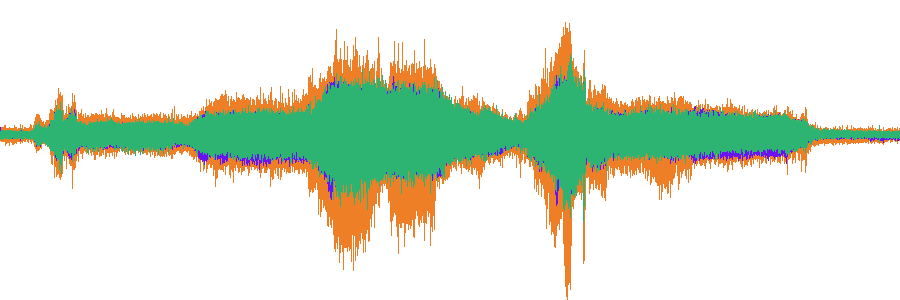

In [ ]:
imgs, total = datashader_large_time(df_vibe,'timestamp',colors)
tf.stack(*imgs)

In [ ]:
def display_all_imgs(imgs,names,colors):
  for i in range(len(imgs)):
    fig = px.imshow(imgs[i],
                    color_continuous_scale  = [ [0, 'rgba(255,255,255,0)'], [1, colors[i]] ],
                    origin='lower')
    fig.update_layout(
      {**template_dark, **template_accel}, 
      title_text = 'Large Time Series with Datashader - '+names[i],
      coloraxis_showscale = False)
    fig.show()

In [ ]:
display_all_imgs(imgs,df_vibe.columns,colors)

In [ ]:
fig = px.imshow(total,
                color_continuous_scale  = [ [0, colors[0]], [1, 'rgba(255,255,255,0)'] ],
                origin='lower')
fig.update_layout(
  {**template_dark, **template_accel}, 
  title_text = 'Large Time Series with Datashader - Merged',
  coloraxis_showscale = False)
fig.show()

That last example was a meager 400,000 data points, what happens when we have 6 million!

In [ ]:
doc = endaq.ide.get_doc('https://info.endaq.com/hubfs/ford_f150.ide',quiet=True)
df_long = endaq.ide.to_pandas(doc.channels[8],time_mode='seconds')
df_long = df_long - df_long.median()
df_long

,X (100g),Y (100g),Z (100g)
timestamp,,,
0.715484,6.054797,3.714581,-1.500087
0.715684,5.657761,3.765466,-1.354917
0.715884,5.459243,3.612812,-1.500087
0.716084,5.757020,3.969005,-1.645257
0.716284,6.203685,4.070774,-2.032376
...,...,...,...
1207.574669,0.645183,1.984502,-1.306527
1207.574869,0.843701,2.086272,-1.306527
1207.575069,0.496295,2.086272,-1.064578


In [ ]:
imgs, total = datashader_large_time(df_long,'timestamp',colors)

fig = px.imshow(total,
                color_continuous_scale  = [ [0, colors[0]], [1, 'rgba(255,255,255,0)'] ],
                origin='lower')
fig.update_layout(
  {**template_dark, **template_accel}, 
  title_text = 'Large Time Series with Datashader - Merged',
  coloraxis_showscale = False)
fig.show()

Now let's get crazy and do a VERY large file with 64 million samples, the file is 385 MB. Note that the free version of Colab will run out of memory if you try this file...

In [ ]:
doc = endaq.ide.get_doc('https://info.endaq.com/hubfs/data/Mining-Data.ide',quiet=True)
df_very_long = endaq.ide.to_pandas(doc.channels[8],time_mode='seconds')
df_very_long = df_very_long - df_very_long.median()
df_very_long

,X,Y,Z
timestamp,,,
22562.056030,-3.604027,-4.576728,0.000000
22562.056080,1.201342,-1.144182,2.341676
22562.056130,2.402685,0.000000,-5.854189
22562.056180,3.604027,0.000000,0.000000
22562.056230,-2.402685,0.000000,-3.512513
...,...,...,...
25785.220503,-6.006712,-1.144182,0.000000
25785.220553,-9.610740,0.000000,-3.512513
25785.220603,-12.013425,2.288364,0.000000


In [ ]:
imgs, total = datashader_large_time(df_very_long,'timestamp',colors)

fig = px.imshow(total,
                color_continuous_scale  = [ [0, colors[0]], [1, 'rgba(255,255,255,0)'] ],
                origin='lower')
fig.update_layout(
  {**template_dark, **template_accel}, 
  title_text = 'VERY Large (64M) Time Series with Datashader - Merged',
  coloraxis_showscale = False)
fig.write_html('large-time-image.html',full_html=False,include_plotlyjs='cdn') 
fig.show()

## Wait, What're Graph Objects?


### Adding to a Figure
Because Plotly Express has become so versatile you really only need to use graph_objects when adding to a figure already created by express. Let's demonstrate by adding half sine best fits to our shock response spectrum.

In [ ]:
fig = px.line(df_pvss,
              color_discrete_sequence=colors)

fig.update_layout(
  {**template_dark, **template_pvss}, 
  title_text = 'Motorcyle Crash Test with Best Fit Half Sine Pulses')

fig.show()

In [ ]:
damp=0.05
t = np.linspace(0,0.5,num=int(10000))  # NOTE: if there aren't enough samples, low-frequency artifacts will appear!

def half_sine_pulse(t, T):
    """Given a pulse width (T) and total time (t) generate a time series of the pulse with an amplitude of 1."""
    result = np.zeros_like(t)
    result[(t > 0) & (t < T)] = np.sin(np.pi*t[(t > 0) & (t < T)] / T)
    df_result = pd.DataFrame({'Time':t,
                              'Pulse':result}).set_index('Time')
    return df_result  

In [ ]:
for var,color in zip(df_pvss.columns,colors):
  half_sine_params = endaq.calc.shock.enveloping_half_sine(df_pvss[var]/9.81/39.37, damp=damp)
  
  df_pvss_pulse = endaq.calc.shock.pseudo_velocity(half_sine_params[0] * half_sine_pulse(t, T=half_sine_params[1]),
                                                   freqs=df_pvss.index, damp=damp)    
  
  fig.add_trace(go.Scatter(
      x=df_pvss_pulse.index,
      y=df_pvss_pulse['Pulse'].to_numpy()*9.81*39.37,
      mode="lines",
      line = dict(color=color, width=1,dash='dash'),
      name=var+': Half Sine ('+str(np.round(half_sine_params[1],5))+'s, '+str(np.round(half_sine_params[0],1))+'g)'
  ))

fig.show()  

### Creating a Heatmap

In [ ]:
from scipy import signal

def spectrogram(df,win,max_freq):
  """Generate a Spectrogram with a defined frequency window size and maximum frequency"""
  fs = len(df)/(df.index[-1]-df.index[0])
  N = int(fs*win) #Number of points in the fft
  w = signal.blackman(N)
  output = []
  figs = []
  for c in df.columns:
    freqs, bins, Pxx = signal.spectrogram(df[c].to_numpy(), fs,window = w,nfft=N,axis=0)
    Pxx = Pxx[:max_freq,:]
    freqs = freqs[:max_freq]
    output.append(Pxx)

    #Generate Figures
    trace = [go.Heatmap(
        x= bins,
        y= freqs,
        z= 10*np.log10(Pxx),
        colorscale='Jet',
        )]
    layout = go.Layout(
        yaxis = dict(title = 'Frequency (Hz)'), # x-axis label
        xaxis = dict(title = 'Time (s)'), # y-axis label
        )
    fig = go.Figure(data=trace, layout=layout)
    figs.append(fig)

  return freqs,bins,output,figs

In [ ]:
freqs,bins,output,figs = spectrogram(df_vibe,0.5,200)

figs[1].update_layout(template_dark,
                      title_text = 'Spectrogram with Graph Objects')
figs[1].write_html('spectrogram.html',full_html=False,include_plotlyjs='cdn') 
figs[1].show()

### 4 Coordinate or Tripartite Plot

Let's say I want to make a 4 coordinate plot for shock response spectrums like what I showed in [the blog](https://blog.endaq.com/shock-analysis-response-spectrum-srs-pseudo-velocity-severity):

![motorcycle-collision-pseudo-velocity-filtering-response-4cp.svg](https://blog.endaq.com/hubfs/motorcycle-collision-pseudo-velocity-filtering-response-4cp.svg)

This would be a great example of when to use graph_objects to add all these diagonal lines.

### Supporting Functions
This will be updated and included in our open enDAQ Library.

In [ ]:
def log_ticks(start,stop):
  """Create an array of values that would be the equivalent of tick marks in a log scaled plot"""
  start = np.floor(np.log10(start))
  stop = np.ceil(np.log10(stop))
  ones = np.linspace(1,9,9)
  output = ones*(10**start)
  for i in np.arange(start+1,stop,1):
    output = np.concatenate((output,
                             ones*(10**i)))
  return np.concatenate((output,np.array([10**stop])))

def build_mult_df(rows,columns,scalar=1,row_exp=1,col_exp=1):
  """Multiply two arrays by each other to form a matrix with defined scalar and exponents"""
  rows2 = np.reshape(rows,(len(rows),1))
  columns2 = np.reshape(columns,(1,len(columns)))
  return pd.DataFrame(data=(rows2**row_exp)*(columns2**col_exp)*scalar,
                      index=rows,
                      columns=columns)
  
def add_df(fig,df,units):
  """Add lines for each column in a dataframe to an existing figure"""
  for col in df.columns:
    fig.add_trace(go.Scatter(
      x=df.index,
      y=df[col].to_numpy(),
      mode="lines",
      line = dict(color='#404041', width=1,dash='dot'),
      showlegend=False,
      name=str(col)+units
  ))
  return fig  

In [ ]:
def add_4cp_pvss(fig,df_pvss):
  """Given a figure and the dataframe of pseudo velocity (in/s) add the 4 coordinate plot diagonals"""
  max_vel = np.ceil(np.log10(df_pvss.max(axis=1).max()))
  min_vel = np.floor(np.log10(df_pvss.min(axis=1).min()))

  min_disp = (10**min_vel)/df_pvss.index[-1]/(2*np.pi)
  max_disp = (10**max_vel)/df_pvss.index[0]/(2*np.pi)

  disps = build_mult_df(df_pvss.index,
                       log_ticks(min_disp,max_disp),
                       scalar=(2*np.pi))
  disps = disps[(disps<(10**max_vel)) & (disps>(10**min_vel))]

  major_disps = disps.columns[np.remainder(np.log10(disps.columns),1)==0]
  for disp in major_disps:
    disp_str = str(disp) + " in"
    if disp>=1:
      disp_str = f"{disp:.0f}" + " in"      
    x = (10**max_vel)/(disp*2*np.pi)
    if (x < df_pvss.index[-1]) & (x > df_pvss.index[0]):\
      fig.add_annotation(x=np.log10(x)-.1, y=max_vel,
              text=disp_str,
              textangle=-45,
              showarrow=False)

  min_accel = (10**min_vel)*df_pvss.index[0]*(2*np.pi)/(9.81*39.37)
  max_accel = (10**max_vel)*df_pvss.index[-1]*(2*np.pi)/(9.81*39.37)

  accels = build_mult_df(df_pvss.index,
                       log_ticks(min_accel,max_accel),
                       scalar=9.81*39.37/(2*np.pi),
                       row_exp=-1)
  accels = accels[(accels<(10**max_vel)) & (accels>(10**min_vel))]

  major_accels = accels.columns[np.remainder(np.log10(accels.columns),1)==0]
  for accel in major_accels:
    accel_str = str(accel) + " g"
    if accel>=1:
      accel_str = f"{accel:.0f}" + " g" 
    y = accel / (df_pvss.index[-1] * 2 * np.pi) * (9.81*39.37)
    if (y < 10**max_vel) & (y > 10**min_vel):
      fig.add_annotation(x=np.log10(df_pvss.index[-1]), y=np.log10(y)+.1,
              text=accel_str,
              textangle=45,
              showarrow=False)  

  add_df(fig,disps,' in')  
  add_df(fig,accels,' g')  

  fig.update_yaxes(range=[min_vel,max_vel])
  fig.update_xaxes(range=np.log10([df_pvss.index[0],df_pvss.index[-1]]))

  return fig

#### Motorcycle Crash

In [ ]:
fig = px.line(df_pvss,
              color_discrete_sequence=colors)

fig = add_4cp_pvss(fig,df_pvss)

fig.update_layout(
  {**template_light, **template_pvss}, 
  title_text = 'Motorcyle Crash Test in 4CP',
  width=600,
  height=600)
fig.write_html('4cp.html',full_html=False,include_plotlyjs='cdn') 
fig.show()

#### El Centro Earthquake
[Data credit of good ol' Tom Irvine](http://www.vibrationdata.com/elcentro.htm), the El Centro earthquake in 1940.

![](http://www.vibrationdata.com/Resources/elc3.jpg)

In [ ]:
df_elcentro = pd.read_csv('https://info.endaq.com/hubfs/elcentro_earthquake.csv',index_col=0)

fig = px.line(df_elcentro)
fig.update_layout(
  {**template_light, **template_accel}, 
  title_text = 'El Centro Earthquake Acceleration')

fig.show()

In [ ]:
df_pvss_elcentro = endaq.calc.shock.pseudo_velocity(df_elcentro, 
                                                    get_log_freqs(df_elcentro,init_freq=.1,bins_per_octave=12),
                                                    damp=0.05, two_sided=False)
df_pvss_elcentro = df_pvss_elcentro*9.81*39.37 #convert to in/s

In [ ]:
fig = px.line(df_pvss_elcentro,
              color_discrete_sequence=colors)

fig = add_4cp_pvss(fig,df_pvss_elcentro)

fig.update_layout(
  {**template_light, **template_pvss}, 
  title_text = 'El Centro Earthquake in 4CP',
  showlegend = False,
  width=600,
  height=600)

fig.show()

## Sub Plots

### Install & Load Libraries

In [ ]:
!pip install -U -q numpy scipy plotly pandas
exit()

     |████████████████████████████████| 15.7 MB 5.1 MB/s 
     |████████████████████████████████| 28.5 MB 56.8 MB/s 
     |████████████████████████████████| 11.3 MB 24.4 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.6.0 requires numpy~=1.19.2, but you have numpy 1.21.2 which is incompatible.
gym 0.17.3 requires cloudpickle<1.7.0,>=1.2.0, but you have cloudpickle 2.0.0 which is incompatible.
google-colab 1.0.0 requires pandas~=1.1.0; python_version >= "3.0", but you have pandas 1.3.3 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
import numpy as np
import pandas as pd
import scipy

import plotly.express as px
import plotly.graph_objects as go

import endaq

def get_dfs_from_doc(doc, display_table=True, time_mode='seconds'):
  """Extract dataframes from all channels, separating subchannels to their own dataframe if they have different units"""
  table = endaq.ide.get_channel_table(doc)
  if display_table:
    display(table)
  for i in table.data.index:
    table.data.loc[i, 'parent'] = table.data['channel'].loc[i].parent.id

  dfs = []
  labels = []
  for ch in doc.channels:
    df = endaq.ide.to_pandas(doc.channels[ch],time_mode=time_mode)
    units = table.data[table.data.parent == doc.channels[ch].id].units.unique()
    types = table.data[table.data.parent == doc.channels[ch].id].type.unique()
    for unit,d_type in zip(units,types):
      columns = table.data[(table.data.parent == doc.channels[ch].id) & (table.data.units == unit)].name
      dfs.append(df[columns])
      labels.append(d_type + ' (' + unit + ')')
      
  return dfs, labels      

def merge_dfs(dfs,labels,plot_points=500,mean_thresh=100):
  """Combine dataframes into one merged one, but downsample to moving RMS for datasets with fast sampling rates, and moving mean for slower data sets"""
  master_df = pd.DataFrame()
  for df, label in zip(dfs,labels):
    f_s = dt = (len(df.index) - 1) / (df.index[-1] - df.index[0])
    n = int(df.shape[0]/plot_points) #number of data points to use in windowing
    if n>0:
      if f_s > mean_thresh:
        df = df.rolling(n).std().iloc[::n] 
      else:
        df = df.rolling(n).mean().iloc[::n] 

    for col in df.columns:
      df_temp = df[col].to_frame()
      df_temp.columns = ['Value']
      df_temp['Name'] = label + ': ' + col
      df_temp['Units'] = label
      df_temp = df_temp.reset_index()
      master_df = pd.concat([master_df,df_temp])
  return master_df    

In [ ]:
template_light = dict(
  template="presentation",

  font_family='Open Sans',
  font_size=16,
  font_color='#404041',

  title_font_family = 'Open Sans ExtraBold',
  title_font_size = 24,
  title_x = 0.5,

  xaxis_title_font_family = 'Open Sans ExtraBold',
  xaxis_title_font_size = 20,

  yaxis_title_font_family = 'Open Sans ExtraBold',
  yaxis_title_font_size = 20,

  legend_title='',
  legend_orientation='h',
  legend_y = -0.2,
  
  plot_bgcolor = '#f3f3f3',
  yaxis_gridcolor = '#dad9d8',
  yaxis_linecolor = '#404041',
  yaxis_mirror = True,
  xaxis_gridcolor = '#dad9d8',
  xaxis_linecolor = '#404041',
  xaxis_mirror = True,  
  )

template_dark = template_light.copy()
template_dark['template'] = "plotly_dark"
template_dark['font_color'] = '#f3f3f3'
template_dark['plot_bgcolor'] = "#111111"
template_dark['yaxis_linecolor'] = "#404041"
template_dark['xaxis_linecolor'] = "#404041"
template_dark['yaxis_gridcolor'] = "#404041"
template_dark['xaxis_gridcolor'] = "#404041"

colors = ['#EE7F27', '#6914F0', '#2DB473', '#D72D2D', '#3764FF', '#FAC85F','#27eec0','#b42d4d','#82d72d','#e35ffa']

template_pvss = dict(
  xaxis_title_text = "Natural Frequency (Hz)",
  xaxis_type = 'log',
  yaxis_title_text ="Pseudo Velocity (in/s)",
  yaxis_type = 'log'
)

template_psd = dict(
  xaxis_title_text = "Frequency (Hz)",
  xaxis_type = 'log',
  yaxis_title_text ="Acceleration (g^2/Hz)",
  yaxis_type = 'log'
  )

template_accel = dict(
  xaxis_title_text = "Time (s)",
  yaxis_title_text ="Acceleration (g)",
  )

### Load Data

In [ ]:
doc = endaq.ide.get_doc('https://info.endaq.com/hubfs/data/All-Channels.ide', quiet=True)
dfs, labels = get_dfs_from_doc(doc, display_table=True)

,channel,name,type,units,start,end,duration,samples,rate
0,8.0,X (25g),Acceleration,g,00:00.0338,03:09.0342,03:09.0003,944990,4999.85 Hz
1,8.1,Y (25g),Acceleration,g,00:00.0338,03:09.0342,03:09.0003,944990,4999.85 Hz
2,8.2,Z (25g),Acceleration,g,00:00.0338,03:09.0342,03:09.0003,944990,4999.85 Hz
3,8.3,Mic,Audio,A,00:00.0338,03:09.0342,03:09.0003,944990,4999.85 Hz
4,80.0,X (40g),Acceleration,g,00:00.0341,03:09.0365,03:09.0024,94603,500.48 Hz
5,80.1,Y (40g),Acceleration,g,00:00.0341,03:09.0365,03:09.0024,94603,500.48 Hz
6,80.2,Z (40g),Acceleration,g,00:00.0341,03:09.0365,03:09.0024,94603,500.48 Hz
7,84.0,X,Rotation,deg/s,00:00.0431,03:09.0516,03:09.0085,612935,3241.58 Hz
8,84.1,Y,Rotation,deg/s,00:00.0431,03:09.0516,03:09.0085,612935,3241.58 Hz
9,84.2,Z,Rotation,deg/s,00:00.0431,03:09.0516,03:09.0085,612935,3241.58 Hz


In [ ]:
merged_dfs = merge_dfs(dfs,labels,plot_points=100)
merged_dfs

,timestamp,Value,Name,Units
0,0.338775,NaN,Acceleration (g): X (25g),Acceleration (g)
1,2.228761,0.012966,Acceleration (g): X (25g),Acceleration (g)
2,4.118748,0.004471,Acceleration (g): X (25g),Acceleration (g)
3,6.008682,0.009458,Acceleration (g): X (25g),Acceleration (g)
4,7.898544,0.010230,Acceleration (g): X (25g),Acceleration (g)
...,...,...,...,...
103,181.239308,88.318638,Light (Ill): Lux,Light (Ill)
104,182.993142,200.759452,Light (Ill): Lux,Light (Ill)
105,184.746975,124.224819,Light (Ill): Lux,Light (Ill)
106,186.500809,113.725342,Light (Ill): Lux,Light (Ill)


### Facet Plot

In [ ]:
fig = px.line(merged_dfs,
              x='timestamp',
              y='Value',
              facet_col='Units',
              facet_col_wrap = 4,
              color='Name',
              labels={'Value':''})

fig.update_yaxes(matches=None)
fig.update_layout(
  template="seaborn",
  font_family='Open Sans',
  font_size=16,
  
  title_text = 'Facet Plot of All Channels',
  title_font_family = 'Open Sans ExtraBold',
  title_font_size = 24,

  legend_orientation = 'h',
  height=1000)
fig.write_html('dashboard.html',full_html=False,include_plotlyjs='cdn') 
fig.show()

In [ ]:
fig = px.line(merged_dfs,
              x='timestamp',
              y='Value',
              facet_col='Units',
              facet_col_wrap = 1,
              facet_row_spacing=0.04,
              color='Name',
              labels={'Value':''})

fig.update_yaxes(matches=None)
fig.update_layout(
  template="seaborn",
  font_family='Open Sans',
  font_size=16,
  
  title_text = 'Facet Plot of All Channels',
  title_font_family = 'Open Sans ExtraBold',
  title_font_size = 24,

  height=1000)
fig.show()

## Quaternion Animation

Let's pull in some data from an enDAQ sensor that has quaternions on, something that is impossible to understand! Here is what was done to the device:


1.   Roll +/- 45
2.   Roll +/- 90
3.   Pitch +/- 90
4.   Yaw +/- 90
5.   Roll 720



### Quaternion Line

In [ ]:
doc = endaq.ide.get_doc('https://info.endaq.com/hubfs/data/Roll_Pitch_Yaw.ide',quiet=True)
df_quaternion = endaq.ide.to_pandas(doc.channels[70],time_mode='seconds')
df_quaternion

,X,Y,Z,W
timestamp,,,,
0.217681,0.000549,-0.000366,-0.000244,1.000000
0.258234,0.001099,-0.000488,-0.000488,1.000000
0.298787,0.001404,-0.000244,-0.000488,1.000000
0.339340,0.035522,-0.044434,-0.000427,0.998352
0.379893,0.035522,-0.044434,-0.000610,0.998352
...,...,...,...,...
56.789204,0.087402,-0.025391,-0.067383,0.993591
56.829757,0.086060,-0.030212,-0.068787,0.993469
56.870310,0.081360,-0.031860,-0.068665,0.993774


In [ ]:
fig = px.line(df_quaternion)
fig.update_layout(
    template_light,
    title_text = 'Quaternion',
    xaxis_title_text = 'Time',
    yaxis_title_text = 'Quaternion'
)
fig.show()

### Convert to Euler

In [ ]:
def euler_from_quaternion(df_quaternion):
        """
        Convert a quaternion into euler angles (roll, pitch, yaw)
        roll is rotation around x in radians (counterclockwise)
        pitch is rotation around y in radians (counterclockwise)
        yaw is rotation around z in radians (counterclockwise)
        """
        
        x = df_quaternion['X'].to_numpy()
        y = df_quaternion['Y'].to_numpy()
        z = df_quaternion['Z'].to_numpy()       
        w = df_quaternion['W'].to_numpy()

        t0 = +2.0 * (w * x + y * z)
        t1 = +1.0 - 2.0 * (x * x + y * y)
        roll_x = np.arctan2(t0, t1)
     
        t2 = +2.0 * (w * y - z * x)
        #t2[t2>1] = 1
        #t2[t2<-1] = -1
        pitch_y = np.arcsin(t2)
     
        t3 = +2.0 * (w * z + x * y)
        t4 = +1.0 - 2.0 * (y * y + z * z)
        yaw_z = np.arctan2(t3, t4)
             
        return pd.DataFrame({'Roll':roll_x,
                             'Pitch':pitch_y,
                             'Yaw':yaw_z},
                            index=df_quaternion.index)

### Euler Line

In [ ]:
euler = euler_from_quaternion(df_quaternion)*180/np.pi
euler

,Roll,Pitch,Yaw
timestamp,,,
0.217681,0.062957,-0.041949,-0.028000
0.258234,0.125922,-0.055891,-0.056014
0.298787,0.160879,-0.027898,-0.055992
0.339340,4.085591,-5.088270,-0.230658
0.379893,4.086525,-5.087522,-0.251689
...,...,...,...
56.789204,10.208962,-2.216580,-7.957810
56.829757,10.099325,-2.762193,-8.165903
56.870310,9.573258,-2.989384,-8.155004


In [ ]:
fig = px.line(euler)
fig.update_layout(
    template_light,
    title_text = 'Euler from Quaternion',
    xaxis_title_text = 'Time',
    yaxis_title_text = 'Angle (Degrees)'
)
fig.show()

### Animation with Polar

In [ ]:
df_stacked = pd.DataFrame()
euler_rolled = euler[::10]
for col in euler_rolled.columns:
  df = euler_rolled[col].reset_index()
  df.columns = ['time','value']
  df['time'] = np.round(df['time'],2)
  df['axis'] = col
  df['r'] = 0.5
  df_stacked = pd.concat([df_stacked,df],axis=0)
df_stacked  

,time,value,axis,r
0,0.22,0.062957,Roll,0.5
1,0.62,3.899420,Roll,0.5
2,1.03,1.825449,Roll,0.5
3,1.43,-0.934873,Roll,0.5
4,1.84,-9.934072,Roll,0.5
...,...,...,...,...
135,54.96,1.261520,Yaw,0.5
136,55.37,-0.815223,Yaw,0.5
137,55.78,-3.869159,Yaw,0.5
138,56.18,-6.322262,Yaw,0.5


In [ ]:
fig = px.scatter_polar(df_stacked, r='r', theta="value",color='axis',animation_frame='time')
fig.update_layout(
  template="seaborn",
  font_family='Open Sans',
  font_size=16,
  legend_title_text='',
  title_text = 'Euler Animation',
  title_font_family = 'Open Sans ExtraBold',
  title_font_size = 24,
)
fig.show()

In this representation it is quite easy to see what I did!

1.   Roll +/- 45
2.   Roll +/- 90
3.   Pitch +/- 90
4.   Yaw +/- 90
5.   Roll 720

But... we see some issues with gimbal lock when doing the +/- 90 degree pitch, check out roll and yaw they act like I was spinning around!

### Animation in 3D Space
Now with some proper software developers (thank you Connor!), we can get pretty crazy to present this in 3D space with the coordinate system without any gimbal lock issues.

In [ ]:
rot = scipy.spatial.transform.Rotation.from_quat(np.array([df_quaternion[x] for x in 'XYZW']).T)
X = rot.apply([1, 0, 0])
Y = rot.apply([0, 1, 0])
Z = rot.apply([0, 0, 1])

df_trip = pd.DataFrame({letter + a: r[:, idx] for r, letter in zip([X, Y, Z], ['X', 'Y', 'Z']) for idx, a in enumerate('xyz')}, index=df_quaternion.index)
df_trip

,Xx,Xy,Xz,Yx,Yy,Yz,Zx,Zy,Zz
timestamp,,,,,,,,,
0.217681,1.000000,-0.000489,0.000732,0.000488,0.999999,0.001099,-0.000733,-0.001098,0.999999
0.258234,0.999999,-0.000978,0.000975,0.000975,0.999997,0.002198,-0.000978,-0.002197,0.999997
0.298787,0.999999,-0.000977,0.000487,0.000976,0.999996,0.002808,-0.000490,-0.002807,0.999996
0.339340,0.996051,-0.004010,0.088695,-0.002304,0.997476,0.070970,-0.088756,-0.070894,0.993527
0.379893,0.996050,-0.004376,0.088682,-0.001938,0.997475,0.070986,-0.088769,-0.070878,0.993527
...,...,...,...,...,...,...,...,...,...
56.789204,0.989630,-0.138334,0.038675,0.129457,0.975642,0.177098,-0.062232,-0.170254,0.983433
56.829757,0.988712,-0.141870,0.048189,0.131470,0.975725,0.175146,-0.071867,-0.166833,0.983362
56.870310,0.988539,-0.141667,0.052154,0.131298,0.977330,0.166093,-0.074502,-0.157341,0.984730


In [ ]:
vals = []
for i in range(0, len(X), 10):
  vals.append({'time': df_quaternion.index[i], 'x': 0,       'y': 0,       'z': 0,       'channel': 'X' })
  vals.append({'time': df_quaternion.index[i], 'x': X[i, 0], 'y': X[i, 1], 'z': X[i, 2], 'channel': 'X'})
  vals.append({'time': df_quaternion.index[i], 'x': 0,       'y': 0,       'z': 0,       'channel': 'Y' })
  vals.append({'time': df_quaternion.index[i], 'x': Y[i, 0], 'y': Y[i, 1], 'z': Y[i, 2], 'channel': 'Y'})
  vals.append({'time': df_quaternion.index[i], 'x': 0,       'y': 0,       'z': 0,       'channel': 'Z' })
  vals.append({'time': df_quaternion.index[i], 'x': Z[i, 0], 'y': Z[i, 1], 'z': Z[i, 2], 'channel': 'Z'})
df_rots = pd.DataFrame(vals)
df_rots

,time,x,y,z,channel
0,0.217681,0.000000,0.000000,0.000000,X
1,0.217681,1.000000,-0.000489,0.000732,X
2,0.217681,0.000000,0.000000,0.000000,Y
3,0.217681,0.000488,0.999999,0.001099,Y
4,0.217681,0.000000,0.000000,0.000000,Z
...,...,...,...,...,...
835,56.586438,0.995064,-0.096537,0.022999,X
836,56.586438,0.000000,0.000000,0.000000,Y
837,56.586438,0.090656,0.978539,0.185050,Y
838,56.586438,0.000000,0.000000,0.000000,Z


In [ ]:
df_rots['time'] = np.round(df_rots['time'],2)
fig = px.line_3d(df_rots, x='x', y='y', z='z', color='channel', animation_frame='time')
fig.update_layout(
  template="seaborn",
  font_family='Open Sans',
  font_size=16,
  legend_title_text='',
  title_text = 'Quaternion 3D Animation',
  title_font_family = 'Open Sans ExtraBold',
  title_x = 0.5,
  title_font_size = 24,
  scene=dict(
      xaxis=dict(range=[-1.1, 1.1], nticks=5),
      yaxis=dict(range=[-1.1, 1.1], nticks=5),
      zaxis=dict(range=[-1.1, 1.1], nticks=5),
      aspectmode='cube',
  )
)
fig.write_html('quaternion-3d.html',full_html=False,include_plotlyjs='cdn') 
fig.show()